In [3]:
import numpy as np 
import pickle
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd

In [2]:
file_name = r'../data/centroids_all_NOR_1x1.pkl'
with open(r"../data/centroids_all_NOR_1x1.pkl", "rb") as file:
    df_2018 = pickle.load(file)

df_2018

FileNotFoundError: [Errno 2] No such file or directory: '../data/centroids_all_NOR_1x1.pkl'

In [ ]:
# Ensure geometries are in lat/lon (WGS84)
df_2018 = df_2018.to_crs(epsg=4326)

# Get centroids of polygons
df_2018['centroid'] = df_2018.geometry.centroid

# Extract lat/lon from centroids
df_2018['lat'] = df_2018.centroid.y
df_2018['lon'] = df_2018.centroid.x

# Define bin size
bin_size = 0.08

# Create lat/lon bins
df_2018['lat_bin'] = (df_2018['lat'] / bin_size).round(0) * bin_size
df_2018['lon_bin'] = (df_2018['lon'] / bin_size).round(0) * bin_size

# Sample one centroid per bin
sampled = df_2018.groupby(['lat_bin', 'lon_bin']).sample(n=1, random_state=42).reset_index(drop=True)

print(f"Sampled: {len(sampled)} polygons")


In [5]:
sampled

,geometry,latitude,longitude,centroid,lat,lon,lat_bin,lon_bin
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,POINT (6.99775 58.02829),58.028286,6.997755,58.0,6.96
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,POINT (7.05014 58.02217),58.022171,7.050138,58.0,7.04
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,POINT (7.08638 57.99091),57.990907,7.086381,58.0,7.12
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,POINT (7.21969 58.02657),58.026571,7.219693,58.0,7.20
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,POINT (7.28573 58.02973),58.029728,7.285729,58.0,7.28
...,...,...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,POINT (25.5495 71.16069),71.160690,25.549503,71.2,25.52
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,POINT (25.62173 71.1602),71.160205,25.621730,71.2,25.60
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,POINT (25.66277 71.17527),71.175275,25.662774,71.2,25.68
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,POINT (25.79059 71.16668),71.166685,25.790593,71.2,25.76


### Plotting Samples Distribution

In [4]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

def plotting_samples_norway(df):    
    # Load the shapefile of Norway's boundaries (assuming you have this shapefile)
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Step 2: Plot the map
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Assuming 'result' DataFrame has columns 'longitude' and 'latitude' (from the grid centroids)
    result_geo_df = gpd.GeoDataFrame(
        df, 
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
    
    # Plot the filtered points inside Norway
    result_geo_df.plot(ax=ax, markersize=3, color='red', alpha=0.5, label="Assemblages")
    
    # Customize plot
    ax.set_title("Randomly Sampled Grids 2018", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    
    # Show the plot
    plt.show()

In [5]:
plotting_samples_norway(sampled)

NameError: name 'sampled' is not defined

### Generating Climatic Maps

In [87]:
import netCDF4  # or import h5netcdf
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [88]:
def read_netcdf_stack(file_paths, latitude, longitude, grid):
    patches = []
    # scaler = MinMaxScaler(feature_range=(0, 1))  # Define the scaler

    for file_path in file_paths:
        data = xr.open_dataset(file_path)
        variable = list(data.data_vars.keys())[-1]

        lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
        lon_idx = np.argmin(np.abs(data['lon'].values - longitude))

        patch = data[variable].isel(
            lat=slice(lat_idx - grid, lat_idx + grid),
            lon=slice(lon_idx - grid, lon_idx + grid)
        ).fillna(0).values  # Convert to NumPy

        print(f"Shape of patch for {file_path} {variable}: {patch.shape}")

        # Remove extra dimension if necessary
        if patch.shape[0] == 1:
            patch = patch[0]

        # # Reshape for MinMax scaling (flatten to 2D)
        # patch_reshaped = patch.reshape(-1, 1)  # Flatten but keep 1 feature

        # # Apply MinMax Scaling
        # patch_scaled = scaler.fit_transform(patch_reshaped)

        # # Reshape back to original (grid*2, grid*2)
        # patch_scaled = patch_scaled.reshape(patch.shape)

        # patches.append(patch_scaled)  # Add scaled patch
        
        patches.append(patch)  # Add NOT scaled patch


    # Stack along last axis (channels dimension)
    stacked_patches = np.stack(patches, axis=-1)

    return stacked_patches

In [ ]:
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

variables =['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd']

stacked_patches_list = []
# x = 100
for i in range(sampled.shape[0]): # gbif_assemblages.shape[0]
    sample =  sampled.iloc[i]
    file_paths = [f"C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/{var}/CHELSA_EUR11_obs_{var}_2018_V.2.1.nc" for var in variables]
    file_paths.append(path_altitude)
    
    # Call the function to get the stacked patches
    stacked_patches = read_netcdf_stack(file_paths = file_paths, 
                                        latitude = sample.latitude, 
                                        longitude = sample.longitude, 
                                        grid = 16) # better to use multiples of 64
    
    stacked_patches_list.append(stacked_patches)

    print(f'Sample {i} correctly stacked and added to the list')
    print('\n\n')

Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/gdd5/CHELSA_EUR11_obs_gdd5_2018_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/prsd/CHELSA_EUR11_obs_prsd_2018_V.2.1.nc pr: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio12d/CHELSA_EUR11_obs_bio12d_2018_V.2.1.nc pr: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/swe/CHELSA_EUR11_obs_swe_2018_V.2.1.nc Band1: (32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio01d/CHELSA_EUR11_obs_bio01d_2018_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio04d/CHELSA_EUR11_obs_bio04d_2018_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual

In [93]:
sampled_grids_climatic = sampled.drop(columns=['centroid', 'lat', 'lon', 'lat_bin', 'lon_bin'])#.head(x)

sampled_grids_climatic['climatic_map'] = stacked_patches_list

In [94]:
sampled_grids_climatic

,geometry,latitude,longitude,climatic_map
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 5.593763, 3.3047945, 0.0, 9.25, ..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 5.6080933, 3.2803288, 0.0, 9.25,..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 5.4624677, 3.1708493, 0.0, 9.25,..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 5.474476, 3.171315, 0.0, 9.25, 5..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 5.4336224, 3.1373425, 0.0, 9.25,..."
...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2..."


In [95]:
with open(r'../data/Full_Scale/sampled_grids_bin_008.pkl', "wb") as file_2:
    pickle.dump(sampled_grids_climatic, file_2)

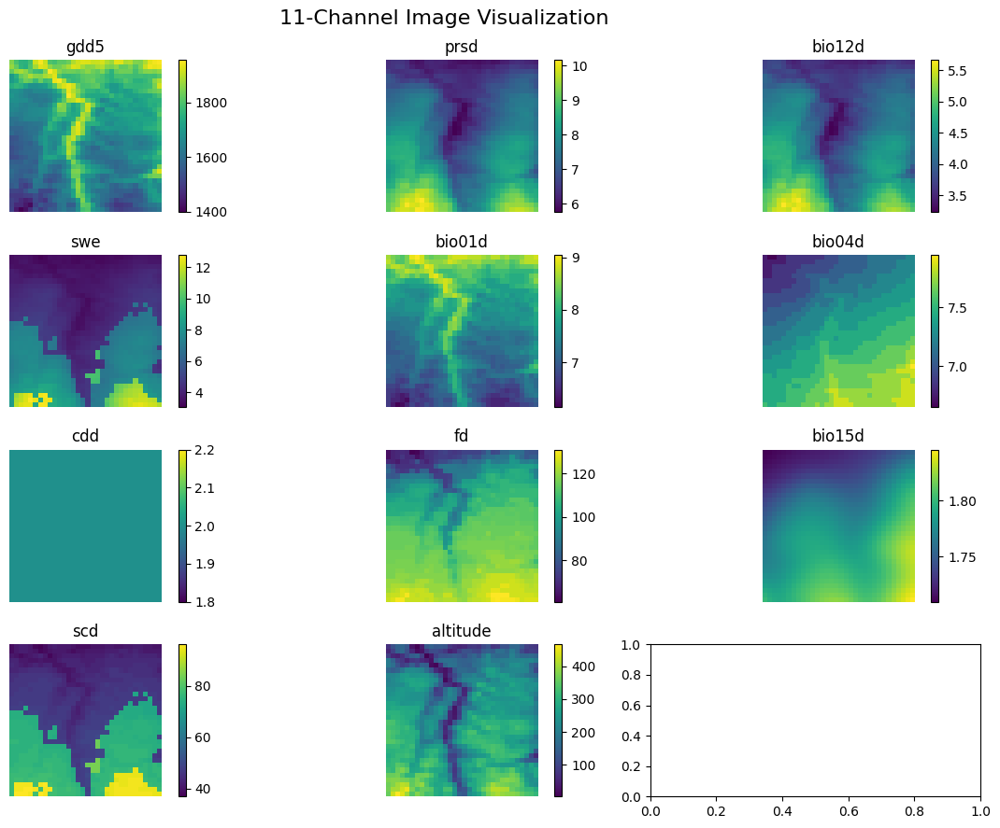

In [96]:
import numpy as np
import matplotlib.pyplot as plt

# Example 10-channel image (Replace with your actual data)
image_10ch = sampled_grids_climatic.iloc[44].climatic_map  # Shape (Height, Width, 10)

# Set up a 3-row, 3-column grid for 9 channels
fig, axes = plt.subplots(4,3, figsize=(12, 9))  # Adjust layout for 9 images
fig.suptitle("11-Channel Image Visualization", fontsize=16)

# Create a color map
cmap = plt.get_cmap("viridis")
variable_names = variables
variable_names.append('altitude')
for i in range(11):  # Loop over the first 9 channels
    ax = axes[i // 3, i % 3]  # Position in grid
    img = ax.imshow(image_10ch[:, :, i], cmap=cmap)  # Use a colormap for visualization
    ax.set_title(f"{variables[i]}")
    ax.axis("off")  # Hide axes

    # Add colorbar for each subplot
    fig.colorbar(img, ax=ax, orientation='vertical')
plt.tight_layout()
plt.show()

### Calculating species Richness

#### Loading Requirements

In [6]:
import json
import random

from tqdm import tqdm
import sys

import geopandas as gpd
from shapely.geometry import Point

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# Import PyTorch
import torch
from torch import nn
import torch.optim as optim
import  torchvision.transforms as transforms

# Import torchvision 
import torchvision
from torchvision import datasets
from torchvision.transforms import ToTensor
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from torchvision import models, transforms

In [7]:
seed = 42  # Choose any number

# Set seed for PyTorch
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)  # If using CUDA
torch.cuda.manual_seed_all(seed)  # If using multi-GPU
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Set seed for NumPy and Python's random module
np.random.seed(seed)
random.seed(seed)

In [8]:
# Load from JSON file
with open(r"../data/species_universe_filtered_10.json", "r") as file:
    species_universe = json.load(file)

In [9]:
class MultiLabelDatasetRescale(Dataset):
    def __init__(self):
        # self.x_train, self.x_val, self.x_test, self.y_train, self.y_val, self.y_test = None, None, None, None, None, None
        self.mode = 'test'
        
         # Stack and convert to float32 tensor
        raw_images = torch.tensor(np.stack(df_2018_resampled['climatic_map'].values).astype(np.float32))  # shape: [N, H, W, C]
        # self.labels = torch.tensor(np.stack(df_2018_resampled['species_vector'].values).astype(np.float32))

        # Transpose to  [C, H, W] for PyTorch
        # raw_images = raw_images.permute(2, 0, 1)
        raw_images = raw_images.permute(0, 3, 1, 2)

        # === NORMALIZE EACH CHANNEL INDEPENDENTLY ===
        # These must match the order of your channels!
        mins = torch.tensor([
            1.9000409841537476,          # gdd5
            1.44621741771698,            # prsd
            0.9102739691734314,          # bio12d
            0.009359435178339481,         # swe
            -9.149993896484375,          # bio01d
            3.1500244140625,             # bio04d
            0.0,                         # cdd
            0.0,                         # fd
            1.0523613691329956,          # bio15d
            0.0,                         # scd
            0.0,                         # altitude
        ])

        maxs = torch.tensor([
            3858.301513671875, # gdd5
            29.09852409362793, # prsd
            21.650711059570312, #bio12d
            113.7122802734375, # swe
            10.45001220703125, #bio01d
            157.55001831054688, #bio04d
            8.0, #cdd
            362.0, # fd
            2.7762691974639893, #bio15d
            365.0, # scd
            2296.0, #altitude
        ])

        # Avoid division by zero (e.g., for crs with constant 0)
        ranges = maxs - mins
        ranges[ranges == 0] = 1  # Prevent division by zero

        # Apply scaling: (x - min) / (max - min)
        # self.images = (raw_images - mins.view(-1, 1, 1)) / ranges.view(-1, 1, 1)

        
        self.images = (raw_images - mins.view(1, -1, 1, 1)) / ranges.view(1, -1, 1, 1)
        self.idx = df_2018_resampled.index.to_list()
        
    def __len__(self):
        if self.mode == 'test':
            
            return len(self.images)


    def __getitem__(self, idx):
        if self.mode == 'test':
            sample = {'images': self.images[idx], 'index': self.idx[idx]}

        return sample

In [10]:
import torch.nn.functional as F
import torch.distributed as dist
import argparse

class CustomLoss(nn.Module):
    def __init__(self, loss_fn, args):
        super(CustomLoss, self).__init__()
        self.loss_fn = loss_fn
        self.weighted = args.weighted
        self.args = args
        if self.weighted:
            self.samples_per_cls = list(args.train_label_cnt.values())
            self.no_of_classes = args.num_classes

    def compute_weights(self, labels, beta=0.9999):
        effective_num = 1.0 - np.power(beta, self.samples_per_cls)
        weights = (1.0 - beta) / np.array(effective_num)
        weights = weights / weights.sum() * self.no_of_classes
        labels_one_hot = labels

        weights = torch.tensor(weights).float().to(self.args.device, non_blocking=True)
        weights = weights.unsqueeze(0)
        weights = weights.repeat(labels_one_hot.shape[0],1) * labels_one_hot
        
        return weights
    
    def forward_focal(self, logits, labels,alpha=0.999,gamma=2.0):
        p = torch.sigmoid(logits)
        ce_loss = F.binary_cross_entropy_with_logits(logits, labels, reduction="none")
        p_t = p * labels + (1 - p) * (1 - labels)
        loss = ce_loss * ((1 - p_t) ** gamma)
        
        if self.weighted:
            weights = self.compute_weights(labels)
            weights_t = weights * labels * alpha + (1 - labels) * (1 - alpha)
            weighted_loss = weights_t * loss
            focal_loss = weighted_loss.mean()
        
        else:
            alpha_t = alpha * labels + (1 - alpha) * (1 - labels)
            focal_loss = alpha_t * loss
            focal_loss = focal_loss.mean()
        
        return focal_loss

    
    def forward_bce(self, logits, labels):
        if self.weighted:
            weights = self.compute_weights(labels)
            bce_loss = F.binary_cross_entropy_with_logits(logits, labels, pos_weight = weights)
        else:
            bce_loss = F.binary_cross_entropy_with_logits(logits, labels)
        
        return bce_loss
    
    
    def forward_dice(self, logits, labels):
        p = torch.sigmoid(logits)
        smooth = 1.0
        intersection = (p * labels).sum(0)
        total = (p**2 + labels**2).sum(0)
        dice_loss = 1 - (intersection + smooth)/(total + smooth)
        
        return dice_loss.mean()
    
    
    def forward(self, logits, labels):
        if self.loss_fn == 'bce':
            return self.forward_bce(logits, labels)
        elif self.loss_fn == 'focal':
            return self.forward_focal(logits, labels)
        elif self.loss_fn == 'dice':
            return self.forward_dice(logits, labels)

In [11]:
class CustomResNet18(nn.Module):
    def __init__(self, num_classes):
        super(CustomResNet18, self).__init__()

        # Load Pretrained ResNet18
        self.resnet = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
        
        # Replace ReLU activations with inplace=False to avoid in-place modification issues
        # self.resnet.relu = nn.ReLU(inplace=False)

        # Modify the first convolutional layer to accept 11 channels instead of 3
        self.resnet.conv1 = nn.Conv2d(11, 64, kernel_size=7, stride=2, padding=3, bias=False)

        # Access layers up to the last block of layer4
        # self.features_conv = self.resnet.layer4[-1]  # Excluding the last block in layer4
        self.hook = self.resnet.layer3[-1].conv2.register_forward_hook(self.hook_fn)
        self.activations = None

        # Modify the final fully connected layer to match the number of classes     
        self.in_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Linear(self.in_features, num_classes)

        # Freeze all layers initially
        for param in self.resnet.parameters():
            param.requires_grad = False

        # Placeholder for gradients
        self.gradients = None

    # Hook for capturing gradients during backward pass
    def activations_hook(self, grad):
        self.gradients = grad
        
    def hook_fn(self, module, input, output):
        # Store activations from the last convolutional layer
        self.activations = output
        
    # Forward pass through the network
    def forward(self, x):
        # Pass through the layers until the last convolutional block
        x = self.resnet.conv1(x)
        x = self.resnet.bn1(x)
        x = self.resnet.relu(x)
        x = self.resnet.maxpool(x)

        # Register the hook on the output of the last convolutional layer (conv2 of the last block)
        x = self.resnet.layer1(x)
        x = self.resnet.layer2(x)
        x = self.resnet.layer3(x)
        x = self.resnet.layer4(x)
        
        # Register hook on the output of the last convolutional layer in layer4[1]
        x.requires_grad_()  # Enable gradient computation for this tensor
        h = x.register_hook(self.activations_hook)
        
        # Continue through the network
        x = self.resnet.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.resnet.fc(x)
        
        return x
    
    def get_embedding(self, x):
        # Forward pass up to avgpool
        x = self.resnet.conv1(x)
        x = self.resnet.bn1(x)
        x = self.resnet.relu(x)
        x = self.resnet.maxpool(x)

        x = self.resnet.layer1(x)
        x = self.resnet.layer2(x)
        x = self.resnet.layer3(x)
        x = self.resnet.layer4(x)

        x = self.resnet.avgpool(x)
        x = torch.flatten(x, 1)  # Shape: [batch_size, 2048]
        return x
    
    # Method to get the captured gradients
    def get_activations_gradient(self):
        return self.gradients

    # Method to get activations from the last convolutional layer (optional)
    def get_activations(self):
        return self.activations
    

#### Evaluating the model

In [12]:
# Load the NumPy array from the pickle file
# with open('../models/old_no_norm/thresholds_focal_RESNET18_49_tss_2017.pkl', 'rb') as f:
#     loaded_thresholds = pickle.load(f)

with open('../models/thresholds_FOCAL_RESNET18_53_tss_1991-2017_full.pkl', 'rb') as f:
    loaded_thresholds = pickle.load(f)
global_threshold = np.mean(loaded_thresholds[np.isfinite(loaded_thresholds)])
global_threshold
# with open('../models/thresholds_BCE_60_tss.pkl', 'rb') as f:
#     loaded_thresholds = pickle.load(f)

np.float32(0.5011627)

In [13]:
PATH = '../models/RESNET18_53_FOCAL_tss_1991-2017_full'
# PATH = '../models/old_no_norm/RESNET18_49_tss_2017'

In [14]:
num_classes = 1819
# device = torch.device('cuda:0')
device = torch.device('cpu')
MODEL = CustomResNet18(num_classes=num_classes).to(device)
# MODEL = CNNModel_1(11,32,num_classes).to(device)

# MODEL.load_state_dict(torch.load(PATH, weights_only=True)) # if GPU is available


MODEL.load_state_dict(torch.load(PATH, weights_only=True, map_location=torch.device(device)))
# model.to(args.device) 
MODEL.eval()

CustomResNet18(
  (resnet): ResNet(
    (conv1): Conv2d(11, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, tr

In [15]:
with open('../data/species_counts_filtered_10_1991_2017.json', 'r') as f:
    class_counts_dict = json.load(f)

In [16]:
# Example args (you can replace it with your actual arguments)
class Args:
    def __init__(self):
        self.weighted = True  # Set to False if no class weighting is needed
        self.train_label_cnt = class_counts_dict  # Example class counts
        self.num_classes = 1819  # Binary classification
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.model_type = 'CNN'
        self.eval = False
        # self.thres_method = 'adaptive'
        self.thres_method = 'global'
        self.threshold = global_threshold

In [17]:
# Function to set the seed for each worker
def seed_worker(worker_id):
    # Set seed for Python and NumPy in each worker
    worker_seed = torch.initial_seed() % 2**32
    np.random.seed(worker_seed)
    random.seed(worker_seed)

In [18]:
with open(r'../data/Full_Scale/sampled_grids_bin_008.pkl', "rb") as file_2:
    df_2018_resampled = pickle.load(file_2)
df_2018_resampled

,geometry,latitude,longitude,climatic_map
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 5.593763, 3.3047945, 0.0, 9.25, ..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 5.6080933, 3.2803288, 0.0, 9.25,..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 5.4624677, 3.1708493, 0.0, 9.25,..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 5.474476, 3.171315, 0.0, 9.25, 5..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 5.4336224, 3.1373425, 0.0, 9.25,..."
...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2..."


In [19]:

args = Args()
mlc_dataset = MultiLabelDatasetRescale()

print(len(mlc_dataset))
# mlc_dataset.train_val_test_split()
dataloader = DataLoader(mlc_dataset, batch_size = 32, shuffle = False, worker_init_fn=seed_worker)

11470


In [20]:
def species_vectors(model, eval_loader, criterion, thresholds, args):
    model.eval()
    # eval_loss = []
    all_preds = {}

    with torch.no_grad():
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            # targets = batch['labels'].to(args.device, non_blocking=True)
            index = batch['index'].to(args.device, non_blocking=True)
            
            outputs = model(samples)
            # loss = criterion(outputs, targets)
            # eval_loss.append(loss.item())

            # Threshold logic
            if args.thres_method == 'adaptive':
                thresholds_tensor = torch.tensor(thresholds, dtype=torch.float32).to(args.device)
            elif args.thres_method == 'global':
                thresholds_tensor = torch.tensor([args.threshold] * outputs.shape[1], dtype=torch.float32).to(args.device)
            else:
                raise ValueError("Unknown threshold method")

            probs = torch.sigmoid(outputs)
            preds = (probs >= thresholds_tensor).float()

            # Append each prediction individually to the list
            for i, pred in zip(index, preds):
                index_number = i.item()

                # print(index_number)
                all_preds[index_number] = pred.cpu().numpy()

    return all_preds

In [21]:
prob_dic = species_vectors(model = MODEL,eval_loader = dataloader, criterion = CustomLoss('focal', args), thresholds = loaded_thresholds, args = Args())


In [22]:
# Wrap each vector in a list so it stays in a single column
preds_df = pd.DataFrame({
    "predicted_vector": [v for v in prob_dic.values()]
}, index=prob_dic.keys())
preds_df

,predicted_vector
0,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
1,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
2,"[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
3,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
4,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
...,...
11465,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11466,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11467,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11468,"[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [23]:
df_2018_with_preds = df_2018_resampled.join(preds_df, how='left')
df_2018_with_preds

,geometry,latitude,longitude,climatic_map,predicted_vector
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 5.593763, 3.3047945, 0.0, 9.25, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 5.6080933, 3.2803288, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 5.4624677, 3.1708493, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 5.474476, 3.171315, 0.0, 9.25, 5...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 5.4336224, 3.1373425, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [24]:
def calculate_sp_richness(species_vectors):
    richness = []
    for i in species_vectors:
        nonzero = np.count_nonzero(i)
        richness.append(nonzero)
    return richness
# df_2018_with_preds['true_richness'] = calculate_sp_richness(df_2018_with_preds['species_vector'])    
df_2018_with_preds['predicted_richness'] = calculate_sp_richness(df_2018_with_preds['predicted_vector'])    
df_2018_with_preds

,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 5.593763, 3.3047945, 0.0, 9.25, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",762
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 5.6080933, 3.2803288, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",684
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 5.4624677, 3.1708493, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",844
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 5.474476, 3.171315, 0.0, 9.25, 5...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",735
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 5.4336224, 3.1373425, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",756
...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",297
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",313
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",301
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",303


In [25]:
def points_species_richness_plot(df, column_name):
    # Load the shapefile of Norway's boundaries
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Assuming 'df' contains your data with species richness in 'column_name' column
    # Step 1: Create GeoDataFrame from the DataFrame
    result_geo_df = gpd.GeoDataFrame(
        df, 
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
     # ✅ Create new figure and axis
    fig, ax = plt.subplots(figsize=(8, 10))
    # Step 2: Plot the map
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Step 3: Plot the points with species richness as colors
    result_geo_df.plot(
        ax=ax, 
        column=column_name,  # Use the column passed to the function
        cmap='YlGnBu',  # Colormap for heatmap, you can try others like 'viridis', 'plasma', etc.
        markersize=3, 
        legend=True,  # Add legend for color scale
        alpha=0.7  # Make points slightly transparent for better visualization
    )
    
    # Customize plot
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.set_title(f"Predicted Species Richness in Norway (2018)", fontsize=15)
    plt.tight_layout()
    # plt.savefig('../Images/SpeciesRichness_11000_samples.png')
    # Show the plots
    plt.show()

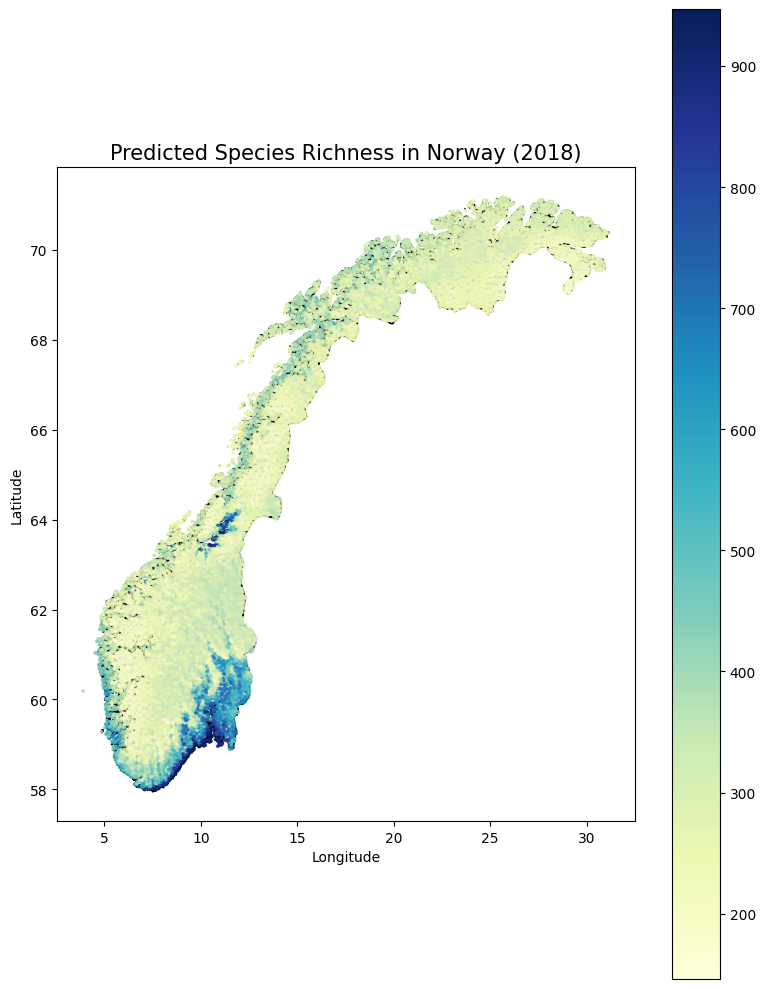

In [26]:
# Plot the predicted richness on the second subplot
points_species_richness_plot(df=df_2018_with_preds, column_name='predicted_richness')

### Clustering Logits

In [25]:
# !pip install umap-learn
import umap.umap_ as umap
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [26]:
def umap_logits(model, eval_loader): 
    all_embeddings = []
    # all_labels = []
    all_indexes = []
    model.eval()
    with torch.no_grad():
        # for data, targets in tqdm(eval_loader, file=sys.stdout):
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            # labels = batch['labels'].to(args.device, non_blocking=True) 
            indexes = batch['index'].to(args.device, non_blocking=True)
            embeddings = model.get_embedding(samples)
            all_embeddings.append(embeddings.cpu().numpy())
            # all_labels.append(labels.cpu().numpy())
            all_indexes.append(indexes.cpu().numpy())
    # Convert to arrays
    X = np.vstack(all_embeddings)  # Shape: [N_samples, 2048]
    # y = np.concatenate(all_labels)
    ind = np.concatenate(all_indexes)
    reducer = umap.UMAP(n_components=3, random_state=42)
    X_umap = reducer.fit_transform(X)

    return X_umap, ind

In [27]:
umap, ind = umap_logits(model = MODEL,eval_loader = dataloader)

C:\Users\Usuario\miniconda3\envs\pytorch\lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Usuario\miniconda3\envs\pytorch\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [28]:
ind

array([    0,     1,     2, ..., 11467, 11468, 11469], shape=(11470,))

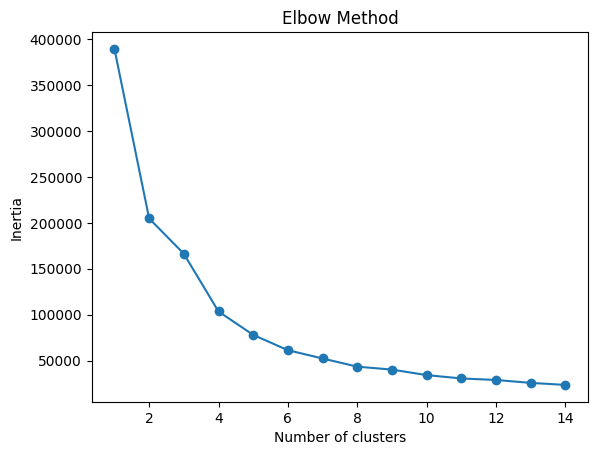

In [29]:
# Optional: Elbow method
inertia = []
for k in range(1, 15):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(umap)
    inertia.append(kmeans.inertia_)

plt.plot(range(1, 15), inertia, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

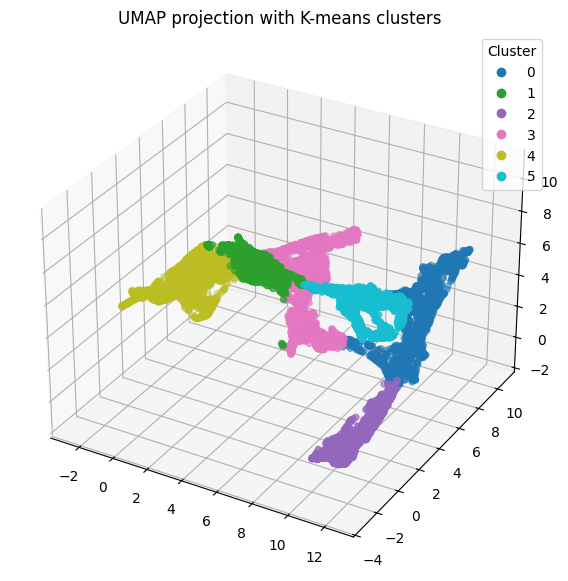

In [30]:
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D

# Final model with chosen K
kmeans = KMeans(n_clusters=6, random_state=42)
clusters = kmeans.fit_predict(umap)

fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(umap[:, 0], umap[:, 1], umap[:, 2],
                     c=clusters, cmap=plt.get_cmap("tab10", len(clusters)), s=20)
ax.set_title("UMAP projection with K-means clusters")
plt.legend(*scatter.legend_elements(), title="Cluster")
plt.show()


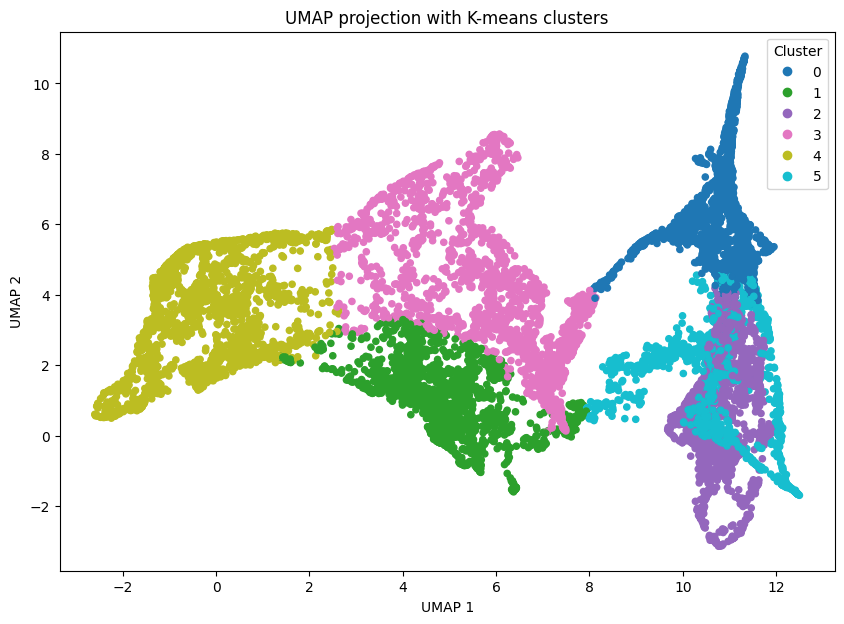

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans

# Final model with chosen K
kmeans = KMeans(n_clusters=6, random_state=42)
clusters = kmeans.fit_predict(umap)

# 2D Plot
plt.figure(figsize=(10, 7))
scatter = plt.scatter(umap[:, 0], umap[:, 1],
                      c=clusters, cmap=plt.get_cmap("tab10", kmeans.n_clusters), s=20)
plt.title("UMAP projection with K-means clusters")
plt.legend(*scatter.legend_elements(), title="Cluster")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.show()


In [31]:
# Creating umap DF
df_umap = pd.DataFrame(umap, columns=["UMAP1", "UMAP2", "UMAP3"])
df_umap["index"] = ind
df_umap["Cluster"] = clusters

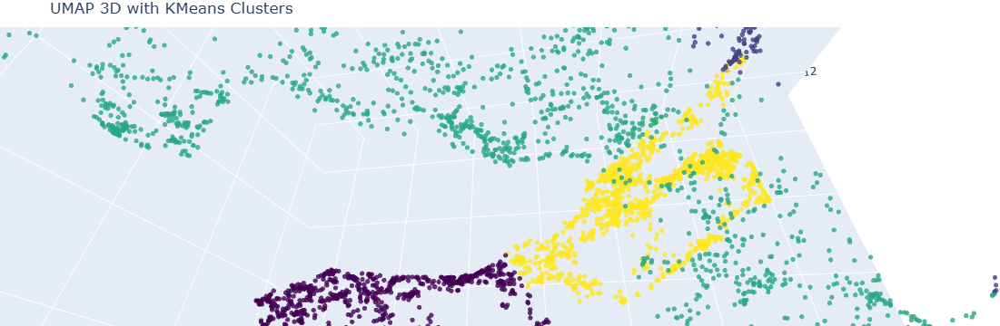

In [32]:

import plotly.graph_objs as go

# Crear figura base
fig = go.Figure(
    data=[go.Scatter3d(
        x=df_umap["UMAP1"],
        y=df_umap["UMAP2"],
        z=df_umap["UMAP3"],
        mode='markers',
        marker=dict(
            size=3,
            color=df_umap["Cluster"],  # Numérico
            colorscale='Viridis',
            opacity=0.8
        ),
        text=df_umap["Cluster"].astype(str),
    )]
)

# Configuración general
fig.update_layout(
    scene=dict(
        xaxis_title='UMAP1',
        yaxis_title='UMAP2',
        zaxis_title='UMAP3'
    ),
    title="UMAP 3D with KMeans Clusters",
    margin=dict(l=0, r=0, b=0, t=30),
)

# No se agregan los frames ni la animación de rotación

fig.show()

# Guardar la figura
fig.write_html(r"../docs/umap_3d_plot_no_rotate.html")




### Plotting UMAP on MAP

In [41]:
df_2018_with_clusters = df_umap.merge(
    df_2018_with_preds,
    left_on='index',      # 'index' column in df_umap
    right_index=True,     # index in df_2018_with_preds
    how='left'
)
df_2018_with_clusters

,UMAP1,UMAP2,UMAP3,index,Cluster,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,-1.344526,12.123018,1.540679,0,2,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 5.593763, 3.3047945, 0.0, 9.25, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",762
1,-1.352582,12.107101,1.556627,1,2,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 5.6080933, 3.2803288, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",684
2,-1.194993,12.447798,1.445644,2,2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 5.4624677, 3.1708493, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",844
3,-1.333814,12.125710,1.514536,3,2,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 5.474476, 3.171315, 0.0, 9.25, 5...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",735
4,-1.320017,12.156716,1.503287,4,2,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 5.4336224, 3.1373425, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",756
...,...,...,...,...,...,...,...,...,...,...,...
11465,8.632759,7.625210,7.687412,11465,1,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",297
11466,8.591860,7.593926,7.650386,11466,1,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",313
11467,8.925093,7.537112,7.461534,11467,3,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",301
11468,9.163692,7.487183,7.214721,11468,3,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",303


In [42]:
import matplotlib.pyplot as plt
import geopandas as gpd
import matplotlib.cm as cm
import matplotlib.colors as mcolors

def plotting_samples_norway_cluster(df):
    # Load Norway shapefile
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)

    # Create figure and axes
    fig, ax = plt.subplots(figsize=(10, 10))

    # Plot Norway outline
    norway.plot(ax=ax, color="lightgray", edgecolor="black")

    # Create GeoDataFrame
    result_geo_df = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"
    )

    # Get sorted unique cluster labels
    clusters = sorted(result_geo_df["Cluster"].unique())

    # Get viridis colormap with N discrete colors
    cmap = plt.get_cmap("tab10", len(clusters))
    colors = [cmap(i) for i in range(len(clusters))]
    cluster_to_color = dict(zip(clusters, colors))

    # Plot each cluster with its color
    for cluster_label in clusters:
        cluster_df = result_geo_df[result_geo_df["Cluster"] == cluster_label]
        cluster_df.plot(
            ax=ax,
            markersize=3,
            label=f"Cluster {cluster_label}",
            color=cluster_to_color[cluster_label],
            alpha=0.8
        )

    # Customize plot
    ax.set_title("Randomly Sampled Grids 2018 with Clusters", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend(title="Cluster", loc="lower right", markerscale=6)

    plt.show()


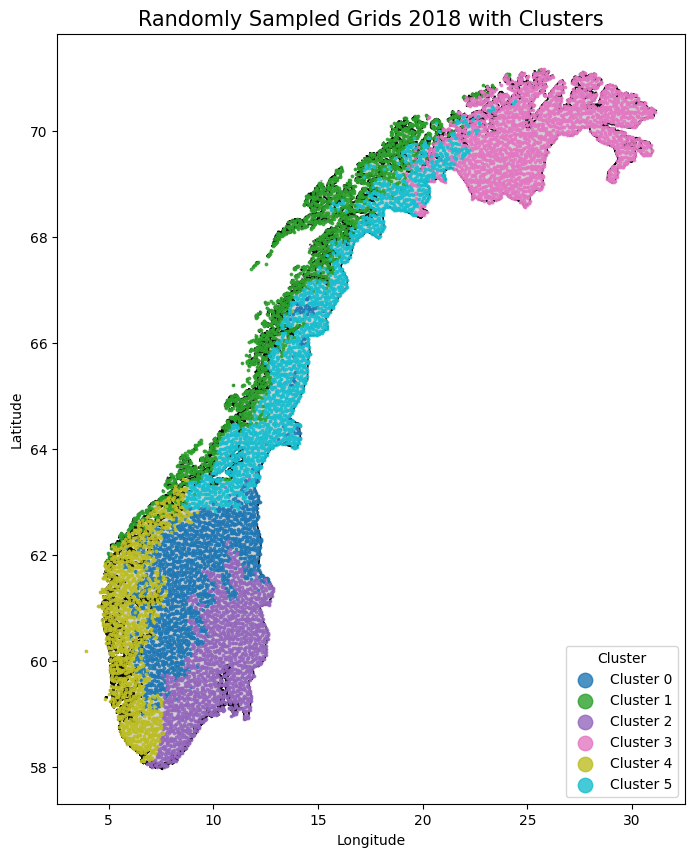

In [43]:
plotting_samples_norway_cluster(df_2018_with_clusters)

Est - west gradient is very strong due to the oceanic influence.

In [44]:
df_2018_with_clusters

,UMAP1,UMAP2,UMAP3,index,Cluster,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,-1.344526,12.123018,1.540679,0,2,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 5.593763, 3.3047945, 0.0, 9.25, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",762
1,-1.352582,12.107101,1.556627,1,2,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 5.6080933, 3.2803288, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",684
2,-1.194993,12.447798,1.445644,2,2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 5.4624677, 3.1708493, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",844
3,-1.333814,12.125710,1.514536,3,2,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 5.474476, 3.171315, 0.0, 9.25, 5...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",735
4,-1.320017,12.156716,1.503287,4,2,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 5.4336224, 3.1373425, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",756
...,...,...,...,...,...,...,...,...,...,...,...
11465,8.632759,7.625210,7.687412,11465,1,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",297
11466,8.591860,7.593926,7.650386,11466,1,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",313
11467,8.925093,7.537112,7.461534,11467,3,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",301
11468,9.163692,7.487183,7.214721,11468,3,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",303


In [45]:
import pandas as pd
import numpy as np

# Assuming 'df' is your DataFrame containing the data with the 'climatic_map' column

# Define a function to calculate the mean per channel
def extract_mean_climatic_map(df):
    # Initialize an empty list to store the results
    mean_values = []

    # Iterate over each row in the dataframe
    for idx, row in df.iterrows():
        # Flatten the climatic_map (assuming it's a list of lists of lists)
        climatic_map = np.array(row['climatic_map'])

        # Compute the mean of the values per channel (assuming each column in the map corresponds to a channel)
        mean_per_channel = climatic_map.mean(axis=(0, 1))  # Mean over the first two dimensions (rows and columns of the map)

        # Store the means for each row
        mean_values.append(mean_per_channel)
        
    variables_list =['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd','alt']


    # Add the mean values as new columns to the dataframe
    mean_values_df = pd.DataFrame(mean_values, columns=[f"{variables_list[i]}" for i in range(mean_values[0].shape[0])])

    # Concatenate the new mean columns to the original dataframe (excluding 'geometry' column)
    df_with_means = pd.concat([df.drop(columns=['geometry']), mean_values_df], axis=1)
    return df_with_means

# Now group by Cluster and calculate the mean for each cluster
df_with_means = extract_mean_climatic_map(df_2018_with_clusters)

# Group by 'Cluster' and calculate the mean of each channel, excluding non-numeric columns
grouped_means = df_with_means.drop(columns=['index','latitude', 'longitude', 'predicted_vector', 'predicted_richness']).groupby('Cluster').mean()




In [46]:
df_with_means

,UMAP1,UMAP2,UMAP3,index,Cluster,latitude,longitude,climatic_map,predicted_vector,predicted_richness,...,prsd,bio12d,swe,bio01d,bio04d,cdd,fd,bio15d,scd,alt
0,-1.344526,12.123018,1.540679,0,2,58.028287,6.997755,"[[[1834.4027, 5.593763, 3.3047945, 0.0, 9.25, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",762,...,6.482895,3.806501,1.356482,8.805695,6.236420,2.361328,44.620117,1.703406,13.768555,39.381836
1,-1.352582,12.107101,1.556627,1,2,58.022171,7.050138,"[[[1838.2527, 5.6080933, 3.2803288, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",684,...,6.355031,3.718071,1.374537,8.823449,6.276072,2.208984,45.326172,1.709676,14.324219,39.798828
2,-1.194993,12.447798,1.445644,2,2,57.990907,7.086381,"[[[1846.6027, 5.4624677, 3.1708493, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, ...",844,...,6.051017,3.532399,0.923731,8.947529,6.195013,2.257812,39.682617,1.713880,9.980469,28.430664
3,-1.333814,12.125710,1.514536,3,2,58.026571,7.219693,"[[[1867.9026, 5.474476, 3.171315, 0.0, 9.25, 5...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",735,...,6.148523,3.569921,1.756143,8.771567,6.541127,2.003906,56.985352,1.722211,19.516602,62.408203
4,-1.320017,12.156716,1.503287,4,2,58.029728,7.285729,"[[[1886.9526, 5.4336224, 3.1373425, 0.0, 9.25,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",756,...,5.981751,3.462507,1.865121,8.800672,6.660556,2.000000,61.579102,1.727303,21.382812,65.273438
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11465,8.632759,7.625210,7.687412,11465,1,71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",297,...,3.522643,2.836527,5.965560,3.727733,5.347385,0.000000,132.818359,1.240558,101.516602,70.623047
11466,8.591860,7.593926,7.650386,11466,1,71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",313,...,3.669620,2.941136,6.264194,3.641420,5.372388,0.000000,134.429688,1.246693,103.591797,82.509766
11467,8.925093,7.537112,7.461534,11467,3,71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",301,...,3.592670,2.875904,6.110562,3.677263,5.293183,0.000000,131.271484,1.248073,102.006836,73.997070
11468,9.163692,7.487183,7.214721,11468,3,71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",303,...,3.544176,2.821650,5.976532,3.686936,5.314583,0.000000,131.128906,1.255139,101.441406,64.622070


In [47]:
# Show the result
grouped_means

,UMAP1,UMAP2,UMAP3,climatic_map,gdd5,prsd,bio12d,swe,bio01d,bio04d,cdd,fd,bio15d,scd,alt
Cluster,,,,,,,,,,,,,,,
0,-0.918556,3.477653,3.180105,"[[[874.9541, 6.892913, 3.9397576, 11.447879, 1...",850.110413,6.705250,3.843238,11.392303,1.352237,9.006439,1.591873,218.662277,1.775077,168.104599,1015.150024
1,5.114852,8.732785,8.336063,"[[[1025.7944, 6.4031167, 4.4267106, 5.8315396,...",1021.793701,6.301574,4.362861,5.538573,4.746202,6.790134,0.885011,130.702103,1.439931,88.293571,131.525284
2,-1.207345,9.358511,-0.001701,"[[[1643.141, 5.270976, 2.5674634, 6.3417096, 5...",1622.999023,5.181875,2.515261,6.441382,5.646605,9.274143,2.968054,158.936249,2.087336,114.973305,384.237396
3,10.241132,6.440385,4.484439,"[[[756.8678, 3.6128068, 2.2302794, 5.339665, 0...",742.660400,3.662981,2.327033,5.563069,0.854163,9.040563,0.069010,208.784607,1.616240,167.379059,301.214935
4,-0.737573,8.563372,7.407641,"[[[1355.4971, 10.883595, 6.6635094, 8.641148, ...",1320.758057,11.243302,6.826684,9.488338,6.013350,6.806991,1.743084,129.797150,1.655283,77.415100,397.756378
5,3.998495,5.802951,5.605359,"[[[848.2949, 6.6860366, 4.3007684, 10.178347, ...",848.141418,6.714906,4.353544,10.170432,1.902751,8.611776,1.052449,201.598297,1.546107,151.914230,537.777649


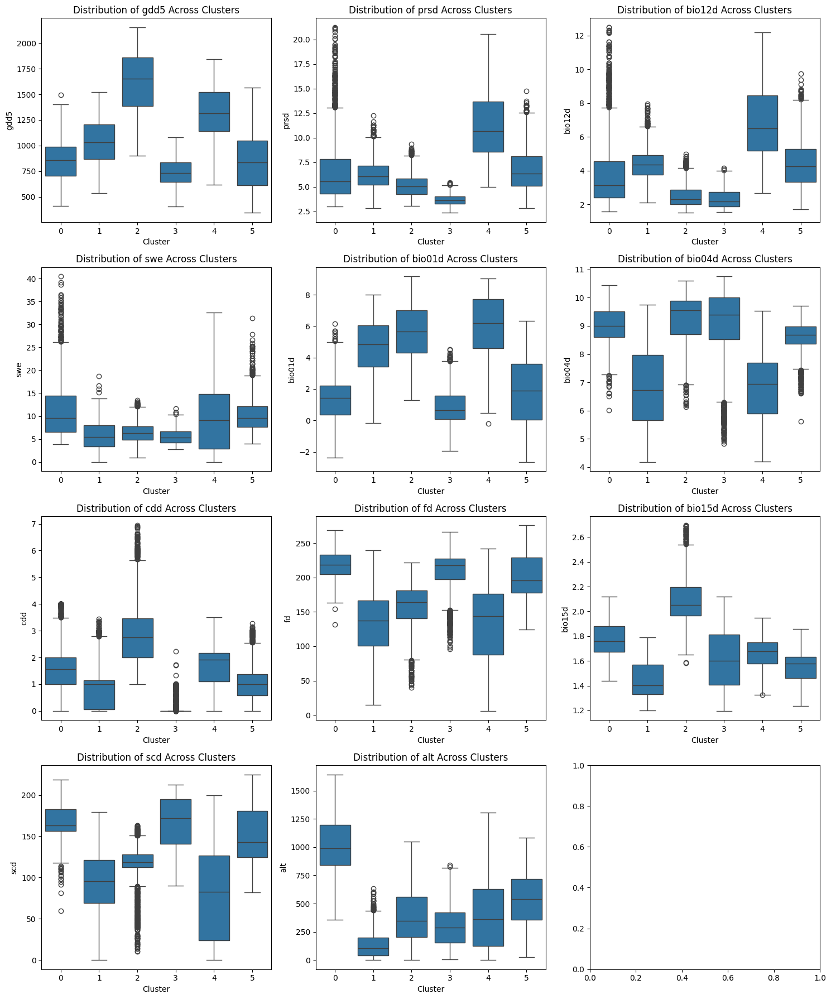

In [48]:
# List of variables
variables = ['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd', 'alt']

# Create a figure and axes for the boxplots
fig, axes = plt.subplots(4, 3, figsize=(15, 18))  # 4 rows and 3 columns for a total of 12 plots
axes = axes.flatten()  # Flatten to easily index the axes

# Loop over each variable and create a boxplot
for i, var in enumerate(variables):
    sns.boxplot(x='Cluster', y=var, data=df_with_means, ax=axes[i])
    axes[i].set_title(f'Distribution of {var} Across Clusters')
    axes[i].set_xlabel('Cluster')
    axes[i].set_ylabel(var)

# Adjust layout
plt.tight_layout()
plt.show()

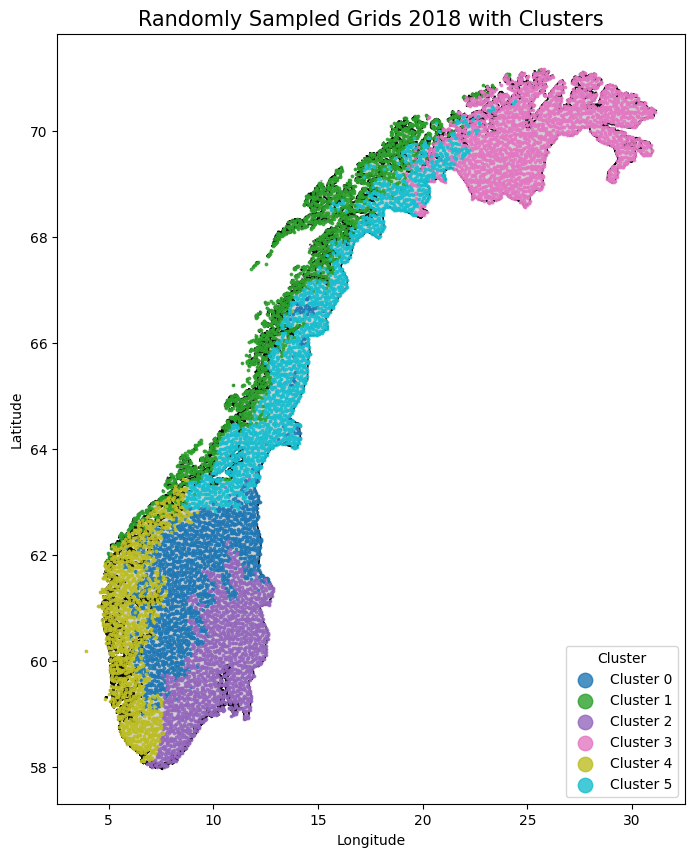

In [49]:
plotting_samples_norway_cluster(df_2018_with_clusters)

### Integrated Gradients

In [50]:
# Load from JSON file
with open(r"../data/species_universe_filtered_10.json", "r") as file:
    species_universe = json.load(file)
# Filter for Salix species and get their indexes
salix_indexes = {species: index for species, index in species_universe.items() if species.lower().startswith('salix')}

# Show the result
print(salix_indexes)

{'Salix myrsinifolia': 175, 'Salix polaris': 243, 'Salix myrtilloides': 411, 'Salix phylicifolia': 419, 'Salix smithiana': 569, 'Salix lanata': 656, 'Salix viminalis': 663, 'Salix arbuscula': 739, 'Salix pentandra': 786, 'Salix daphnoides': 793, 'Salix hastata': 838, 'Salix gmelinii': 847, 'Salix starkeana': 912, 'Salix caprea': 987, 'Salix lapponum': 996, 'Salix reticulata': 1060, 'Salix myrsinites': 1176, 'Salix meyeriana': 1222, 'Salix alba': 1257, 'Salix repens': 1337, 'Salix fragilis': 1341, 'Salix purpurea': 1417, 'Salix glauca': 1510, 'Salix triandra': 1553, 'Salix cinerea': 1559, 'Salix aurita': 1730, 'Salix herbacea': 1795}


In [51]:
def extract_position(model, eval_loader, name, criterion,thresholds,args): 
    selected_images = []
    sp_index = species_universe[name]
    # eval_loss = []
    model.eval()
    with torch.no_grad():
        # for data, targets in tqdm(eval_loader, file=sys.stdout):
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            outputs = model(samples)
                
            # targets = batch['labels'].to(args.device, non_blocking=True)            
            # loss = criterion(outputs, targets)
            # eval_loss.append(loss.item())
            
            if args.thres_method == 'adaptive':
                # thresholds = torch.load(args.output_dir.joinpath('thresholds_train.pth'))
                thresholds = torch.tensor(thresholds, dtype=torch.float32).to(args.device)
                # thresholds = torch.tensor(thresholds).to(args.device)
            elif args.thres_method == 'global':
                thresholds = args.threshold
            
            prob = torch.sigmoid(outputs) >= thresholds
            # label = targets >= thresholds
            
            # print('prob',prob)
            # print('prob shape',prob.shape)

            # print('label',label)
            # print(samples.shape[0])
            # Go through the batch
            for i in range(samples.shape[0]):
                if prob[i][sp_index]:
                    selected_images.append(samples[i].cpu())  



        # eval_loss = torch.tensor(eval_loss).mean().item()

        return selected_images
    

In [52]:
selected_images = extract_position(model = MODEL,eval_loader = dataloader,
                          name = 'Salix reticulata', 
                          criterion = CustomLoss('focal', args), 
                          thresholds = loaded_thresholds, 
                          args = Args())

In [53]:
len(selected_images),selected_images

(5321,
 [tensor([[[0.2189, 0.2239, 0.2241,  ..., 0.3165, 0.3263, 0.3302],
           [0.2370, 0.2356, 0.2276,  ..., 0.3213, 0.3186, 0.3178],
           [0.2402, 0.2380, 0.2324,  ..., 0.3015, 0.2892, 0.2769],
           ...,
           [0.2335, 0.2422, 0.2374,  ..., 0.3155, 0.3030, 0.2843],
           [0.2571, 0.2461, 0.2495,  ..., 0.2943, 0.2989, 0.2948],
           [0.2808, 0.2888, 0.2723,  ..., 0.2626, 0.2883, 0.2933]],
  
          [[0.3797, 0.3808, 0.3844,  ..., 0.2774, 0.2732, 0.2695],
           [0.3691, 0.3727, 0.3795,  ..., 0.2697, 0.2694, 0.2661],
           [0.3662, 0.3702, 0.3761,  ..., 0.2711, 0.2723, 0.2709],
           ...,
           [0.2836, 0.2773, 0.2754,  ..., 0.1925, 0.1930, 0.1965],
           [0.2654, 0.2644, 0.2596,  ..., 0.2050, 0.1995, 0.1977],
           [0.2498, 0.2425, 0.2440,  ..., 0.2218, 0.2088, 0.2032]],
  
          [[0.2825, 0.2835, 0.2863,  ..., 0.1920, 0.1885, 0.1854],
           [0.2750, 0.2778, 0.2830,  ..., 0.1871, 0.1864, 0.1836],
           [0.2

In [55]:
# !pip install captum
from captum.attr import IntegratedGradients

image 1 computed
image 2 computed
image 3 computed
image 4 computed
image 5 computed
image 6 computed
image 7 computed
image 8 computed
image 9 computed
image 10 computed
image 11 computed
image 12 computed
image 13 computed
image 14 computed
image 15 computed
image 16 computed
image 17 computed
image 18 computed
image 19 computed
image 20 computed
image 21 computed
image 22 computed
image 23 computed
image 24 computed
image 25 computed
image 26 computed
image 27 computed
image 28 computed
image 29 computed
image 30 computed
image 31 computed
image 32 computed
image 33 computed
image 34 computed
image 35 computed
image 36 computed
image 37 computed
image 38 computed
image 39 computed
image 40 computed
image 41 computed
image 42 computed
image 43 computed
image 44 computed
image 45 computed
image 46 computed
image 47 computed
image 48 computed
image 49 computed
image 50 computed
image 51 computed
image 52 computed
image 53 computed
image 54 computed
image 55 computed
image 56 computed
i

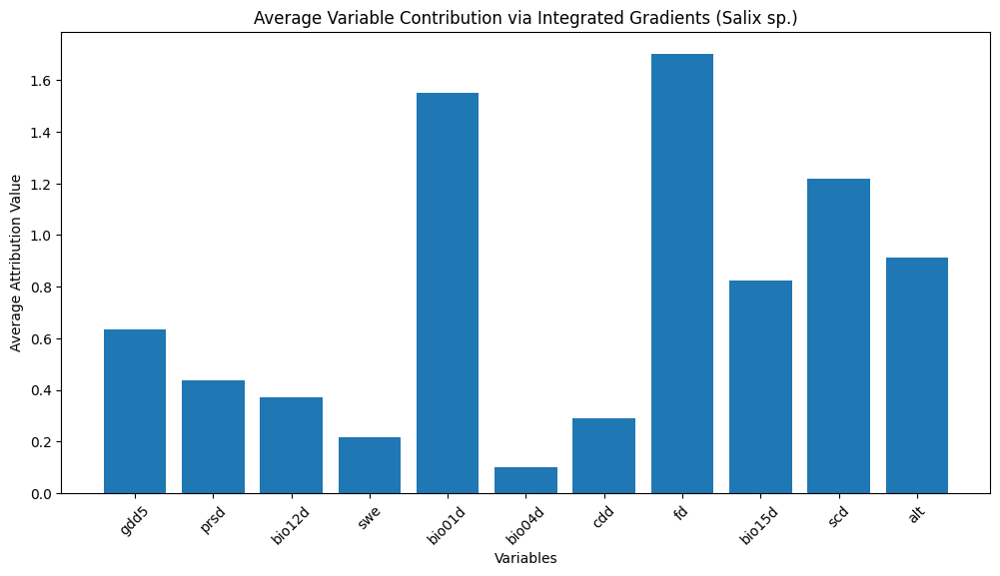

In [61]:
### Modificar para que printe ya directamente en la imagen el titulo de la target Sp

# Move the model to CPU (if it is on GPU)
MODEL = MODEL.to('cpu')

# Assuming selected_images is the list of images from your function
images_tensor = torch.stack(selected_images).to('cpu')  # Move to CPU

# List to store the attribution values for each image
all_channel_attributions = []
ig = IntegratedGradients(MODEL)

x = 0
# Loop through each image one by one
for img in selected_images:
    # Move the image to the correct device
    img_tensor = img.unsqueeze(0).to('cpu')  # Add batch dimension and move to device
    img_tensor.requires_grad_() # recomputar grafico con ordenador xavier
    # Calculate the attribution for the image (target the specific species index, e.g., 1060 for Salix)
    attributions, delta = ig.attribute(img_tensor, target=[1060], return_convergence_delta=True)

    # Aggregate the attribution by summing over height and width
    channel_attributions = torch.sum(torch.abs(attributions), dim=(2, 3))  # Sum over height and width for each channel

    # Convert to numpy and store it
    all_channel_attributions.append(channel_attributions.detach().cpu().numpy())
    x+=1
    # print(f'image {x} computed')

# Convert the list to a numpy array for easier averaging
all_channel_attributions = np.array(all_channel_attributions)

# Calculate the average attribution across all images (axis 0 is the batch dimension)
average_attributions = np.mean(all_channel_attributions, axis=0)

# Plot the average attribution values for each channel
plt.figure(figsize=(12, 6))
plt.bar(range(len(average_attributions[0])), average_attributions[0], tick_label=variables)
plt.title('Average Variable Contribution via Integrated Gradients (Salix sp.)')
plt.xlabel('Variables')
plt.xticks(rotation=45)
plt.ylabel('Average Attribution Value')
plt.show()



We can see that for salix reticulata the most important variables are the frost days (fd), the mean annual air temperature (bio01d) and the snow cover days (scd) as it is a specie that lives on alpine exposed areas with low snow accumulation.

### Plotting 1 species distribution

In [27]:
def plotting_one_species_distribution_norway(df, sp_name):    
    # Load the shapefile of Norway's boundaries (assuming you have this shapefile)
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Get the index of the species in the species_universe
    index = species_universe[sp_name]
    
    # Create a boolean mask to filter rows where the species is present (predicted_vector[index] == 1)
    mask = df['predicted_vector'].apply(lambda x: x[index] == 1)  # Check if species is present in predicted_vector
    
    # Apply the mask to filter the DataFrame
    filtered_df = df[mask]
    filtered_df
    
    # Step 3: Plot the map
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Convert the filtered DataFrame into a GeoDataFrame
    result_geo_df = gpd.GeoDataFrame(
        filtered_df, 
        geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
    
    # Plot the filtered points where the species is present
    result_geo_df.plot(ax=ax, markersize=3, color='red', alpha=0.5, label=f"{sp_name} Presence")
    
    # Customize plot
    ax.set_title(f"{sp_name} Distribution in Norway 2018", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    
    # Show the plot
    plt.show()

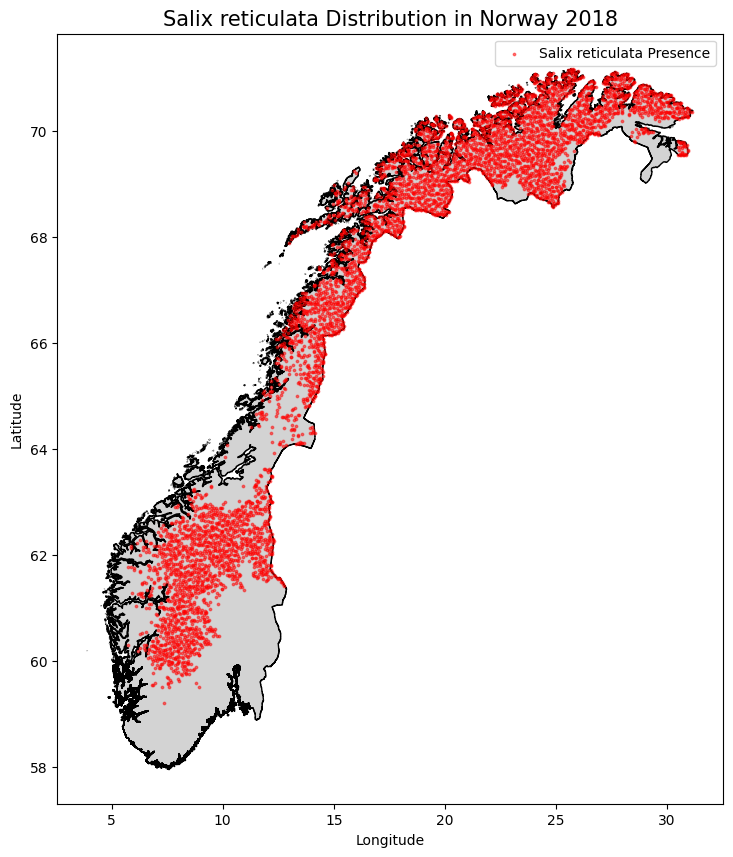

In [29]:
plotting_one_species_distribution_norway(df_2018_with_preds,'Salix reticulata')

### Tests

In [76]:
# Create a boolean mask to filter rows where the species is present (predicted_vector[index] == 1)
specie_index = species_universe['Salix reticulata']
mask = df_2018_with_preds['predicted_vector'].apply(lambda x: x[specie_index] == 1)  # Check if species is present in predicted_vector

# Apply the mask to filter the DataFrame
filtered_df = df_2018_with_preds[mask]
filtered_df

,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
702,"POLYGON ((7.36511 59.20052, 7.36311 59.20943, ...",59.205487,7.372789,"[[[846.0515, 11.944797, 6.769123, 19.826292, 2...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",244
1036,"POLYGON ((6.80914 59.53648, 6.80697 59.54537, ...",59.541479,6.816806,"[[[1063.2517, 16.470514, 9.478959, 20.575836, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",205
1037,"POLYGON ((6.86381 59.53089, 6.86165 59.53978, ...",59.535884,6.871480,"[[[738.00146, 16.818768, 9.74937, 21.670605, 2...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",225
1042,"POLYGON ((7.27896 59.50208, 7.27691 59.51098, ...",59.507048,7.286689,"[[[715.8514, 13.463226, 8.127726, 23.035929, 1...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",237
1045,"POLYGON ((7.55127 59.55403, 7.5493 59.56293, 7...",59.558984,7.559057,"[[[1173.3517, 6.4480596, 3.8052602, 8.6776085,...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...",246
...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",297
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",313
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",301
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",303


In [77]:
mask

0        False
1        False
2        False
3        False
4        False
         ...  
11465     True
11466     True
11467     True
11468     True
11469     True
Name: predicted_vector, Length: 11470, dtype: bool